In [15]:
import xarray as xr
import pygmt

fid_grib = 'grib_2024120200_0012'
ds = []
list_keys = ['pv']
for shortName in ['z', 'lnsp', 't', 'q', 'u', 'v', 'w']:
    print('Reading parameter {}'.format(shortName))
    ds += [ xr.open_dataset(fid_grib,
                          engine='cfgrib',
                          backend_kwargs={'read_keys': list_keys,
                                          'filter_by_keys': 
                                              {'typeOfLevel': 'hybrid',
                                               'shortName': shortName}})]
ds = xr.merge(ds)

print(ds)

# var = ds["t"].sel(...)
# fig = pygmt.Figure()
# fig.grdimage(var, n='b', Q=True)

Reading parameter z
Reading parameter lnsp
Reading parameter t
Reading parameter q
Reading parameter u
Reading parameter v
Reading parameter w
<xarray.Dataset> Size: 0B
Dimensions:  ()
Data variables:
    *empty*
Attributes:
    Conventions:  CF-1.7
    history:      2025-02-02T15:25 GRIB to CDM+CF via cfgrib-0.9.14.1/ecCodes...


In [19]:
import xarray as xr
import pygmt
import matplotlib.pyplot as plt

ds = xr.load_dataset("grib_2024120200_0012", engine="cfgrib", filter_by_keys={'stepType': 'instant', 'typeOfLevel':'surface'})

print(ds)

<xarray.Dataset> Size: 7MB
Dimensions:     (latitude: 400, longitude: 400)
Coordinates:
    time        datetime64[ns] 8B 2024-12-02
    step        timedelta64[ns] 8B 12:00:00
    surface     float64 8B 0.0
  * latitude    (latitude) float64 3kB 39.98 39.95 39.92 ... 28.07 28.04 28.02
  * longitude   (longitude) float64 3kB -2.985 -2.955 -2.925 ... 8.955 8.985
    valid_time  datetime64[ns] 8B 2024-12-02T12:00:00
Data variables:
    t           (latitude, longitude) float32 640kB 294.7 294.6 ... 308.4 308.5
    h           (latitude, longitude) float32 640kB 815.3 831.4 ... 517.9 518.9
    sf          (latitude, longitude) float32 640kB 0.0 0.0 0.0 ... 0.0 0.0 0.0
    tcc         (latitude, longitude) float32 640kB 100.0 100.0 ... 0.0 0.0
    ccc         (latitude, longitude) float32 640kB 0.0 0.0 0.0 ... 0.0 0.0 0.0
    hcc         (latitude, longitude) float32 640kB 100.0 100.0 ... 0.0 0.0
    mcc         (latitude, longitude) float32 640kB 0.0 0.0 0.0 ... 0.0 0.0 0.0
    lcc       

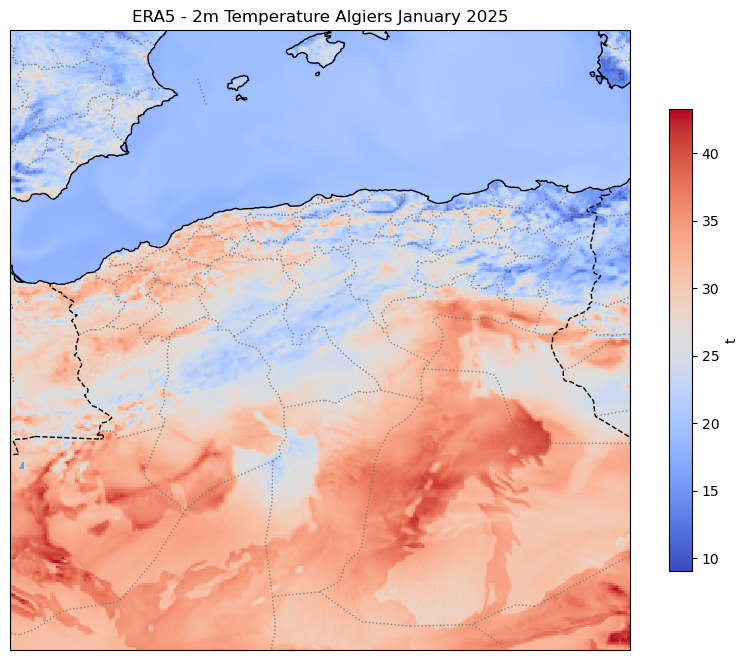

In [49]:
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Load datasets
instant_ds = xr.load_dataset(
    "grib_2024120200_0012",
    engine="cfgrib",
    filter_by_keys={'stepType': 'instant', 'typeOfLevel': 'surface'}
)

accum_ds = xr.load_dataset(
    "grib_2024120200_0012",
    engine="cfgrib",
    filter_by_keys={'stepType': 'accum', 'typeOfLevel': 'surface'}
)

# Merge datasets
combined_ds = xr.merge([instant_ds, accum_ds], compat='override')

# Convert temperature to Celsius
ds = combined_ds['t'] - 273.15  

# Define first-order administrative boundaries
admin_boundaries = cfeature.NaturalEarthFeature(
    category='cultural',
    name='admin_1_states_provinces_lines',
    scale='10m',
    facecolor='none'
)

# Plot
fig = plt.figure(figsize=(10, 10))
ax = plt.axes(projection=ccrs.PlateCarree())

# Add map features
ax.coastlines(resolution="10m")
ax.add_feature(cfeature.BORDERS, linestyle='--', edgecolor='black')  # Country borders
ax.add_feature(admin_boundaries, linestyle=':', edgecolor='gray')  # Departmental boundaries

ds.plot(
    cmap=plt.cm.coolwarm,
    transform=ccrs.PlateCarree(),
    cbar_kwargs={"shrink": 0.6}
)

plt.title("ERA5 - 2m Temperature Algiers January 2025")
plt.show()

In [50]:
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Use interactive mode for zooming and panning in Jupyter
%matplotlib notebook

# Load datasets
instant_ds = xr.load_dataset(
    "grib_2024120200_0012",
    engine="cfgrib",
    filter_by_keys={'stepType': 'instant', 'typeOfLevel': 'surface'}
)

accum_ds = xr.load_dataset(
    "grib_2024120200_0012",
    engine="cfgrib",
    filter_by_keys={'stepType': 'accum', 'typeOfLevel': 'surface'}
)

# Merge datasets
combined_ds = xr.merge([instant_ds, accum_ds], compat='override')

# Convert temperature to Celsius
ds = combined_ds['t'] - 273.15  

# Define first-order administrative boundaries
admin_boundaries = cfeature.NaturalEarthFeature(
    category='cultural',
    name='admin_1_states_provinces_lines',
    scale='10m',
    facecolor='none'
)

# Plot
fig = plt.figure(figsize=(10, 10))
ax = plt.axes(projection=ccrs.PlateCarree())

# Add map features
ax.coastlines(resolution="10m")
ax.add_feature(cfeature.BORDERS, linestyle='--', edgecolor='black')  # Country borders
ax.add_feature(admin_boundaries, linestyle=':', edgecolor='gray')  # Departmental boundaries

# Plot the temperature data
ds.plot(
    cmap=plt.cm.coolwarm,
    transform=ccrs.PlateCarree(),
    cbar_kwargs={"shrink": 0.6}
)

plt.title("ERA5 - 2m Temperature Algiers January 2025")
plt.show()


<IPython.core.display.Javascript object>

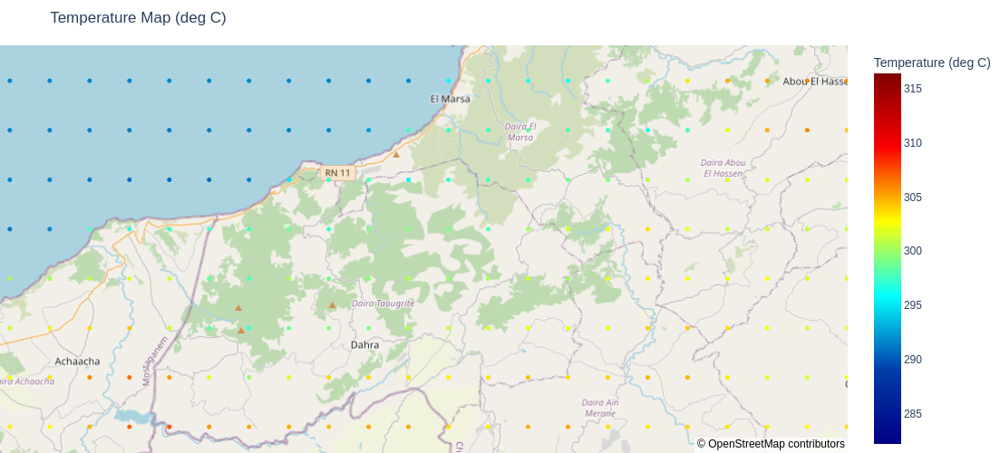

In [53]:
%matplotlib ipympl

import pygrib
import pandas as pd
import plotly.express as px

# Step 1: Open the specific GRIB file
grbs = pygrib.open('grib_2024120200_0012')

# Step 2: Extract the latitude, longitude, and desired variable
# Assuming we are interested in the first GRIB message
grb = grbs.message(1)  # Extract the first message
latitudes, longitudes = grb.latlons()  # Extract latitudes and longitudes
temperature = grb.values  # Extract the variable values (e.g., temperature in meters)

# Step 3: Flatten the data arrays
latitudes = latitudes.flatten()
longitudes = longitudes.flatten()
temperature = temperature.flatten()

# Step 4: Define valid_indices to exclude temperature values ≤ 0
valid_indices = temperature > 0  # This creates a boolean mask

# Apply the filter to exclude invalid values
latitudes = latitudes[valid_indices]
longitudes = longitudes[valid_indices]
temperature = temperature[valid_indices]

# Step 5: Create a DataFrame for Plotly
data = pd.DataFrame({
    'latitude': latitudes,
    'longitude': longitudes,
    'temperature (deg C)': temperature  # Include unit in column name for clarity
})

# Step 6: Plot the data on a map using Plotly Express (with OpenStreetMap)
fig = px.scatter_mapbox(
    data, lat="latitude", lon="longitude", color="temperature (deg C)",
    color_continuous_scale='Jet', hover_name="temperature (deg C)",
    title='Temperature Map (deg C)'
)

# Step 7: Update map layout to use OpenStreetMap
fig.update_layout(
    mapbox_style="open-street-map",  # Set OpenStreetMap style
    mapbox=dict(
        center=dict(lat=latitudes.mean(), lon=longitudes.mean()),  # Center the map
        zoom=3  # Adjust zoom level as needed
    ),
    margin={"r": 0, "t": 50, "l": 0, "b": 0},
    width=800, height=500,
    coloraxis_colorbar=dict(title="Temperature (deg C)")  # Colorbar title
)

# Show the plot
fig.show()

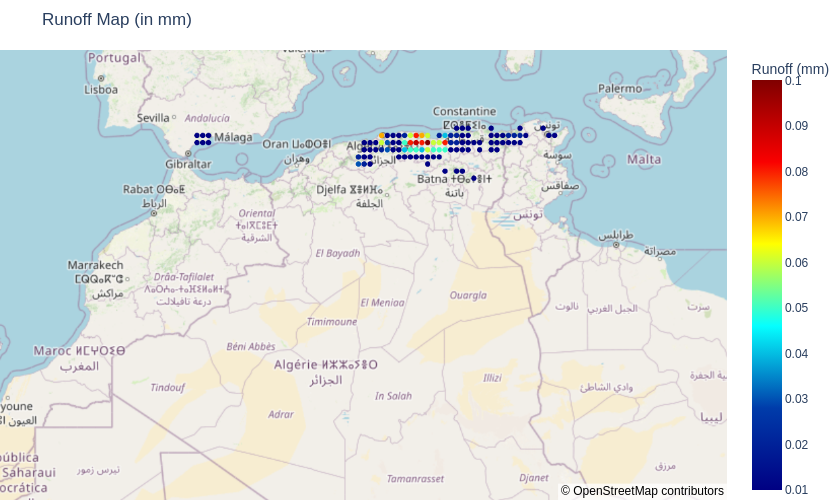

In [20]:
import pygrib
import pandas as pd
import plotly.express as px

# Step 1: Open the specific GRIB file
grbs = pygrib.open('era5.grib')

# Step 2: Extract the latitude, longitude, and desired variable
# Assuming we are interested in the first GRIB message
grb = grbs.message(1)  # Extract the first message
latitudes, longitudes = grb.latlons()  # Extract latitudes and longitudes
runoff = grb.values  # Extract the variable values (e.g., runoff in meters)

# Step 3: Flatten the data arrays
latitudes = latitudes.flatten()
longitudes = longitudes.flatten()
runoff = runoff.flatten()

# Step 4: Convert runoff from meters to millimeters
runoff = runoff * 1000  # Convert meters to millimeters

# Step 5: Round runoff values to 2 decimal places
runoff = runoff.round(2)

# Step 6: Reapply the filter to exclude runoff values ≤ 0
valid_indices = runoff > 0  # Filter for positive runoff values
latitudes = latitudes[valid_indices]
longitudes = longitudes[valid_indices]
runoff = runoff[valid_indices]

# Step 7: Create a DataFrame for Plotly
data = pd.DataFrame({
    'latitude': latitudes,
    'longitude': longitudes,
    'runoff (mm)': runoff  # Include unit in column name for clarity
})

# Step 8: Plot the data on a map using Plotly Express (with OpenStreetMap)
fig = px.scatter_mapbox(
    data, lat="latitude", lon="longitude", color="runoff (mm)",
    color_continuous_scale='Jet', hover_name="runoff (mm)",
    title='Runoff Map (in mm)'
)

# Step 9: Update map layout to use OpenStreetMap
fig.update_layout(
    mapbox_style="open-street-map",  # Set OpenStreetMap style
    mapbox=dict(
        center=dict(lat=latitudes.mean(), lon=longitudes.mean()),  # Center the map
        zoom=3  # Adjust zoom level as needed
    ),
    margin={"r": 0, "t": 50, "l": 0, "b": 0},
    width=800, height=500,
    coloraxis_colorbar=dict(title="Runoff (mm)")  # Colorbar title
)

# Show the plot
fig.show()


In [63]:
import pygrib
import numpy as np

def read_grib_data(filename, parameters=None, expand_grid=False, metadata_fields=None):
    """
    Generalized GRIB file reader for various meteorological parameters.

    Parameters
    ----------
    filename : str
        Path to the GRIB file.
    parameters : list of str, optional
        List of parameter names or short names (e.g., 'Temperature', 'Pressure') to extract.
        If None, extract all available parameters.
    expand_grid : bool, optional
        Whether to expand the grid for interpolation (if applicable).
    metadata_fields : list of str, optional
        List of metadata fields to extract for each parameter. Default is None, which doesn't extract metadata.

    Returns
    -------
    data : dict
        Dictionary containing extracted data and coordinates.
    metadata : dict
        Dictionary containing metadata for each parameter.
    """
    # Define parameter mappings, mapping parameter names to GRIB short names
    param_names = {
        'Temperature': 't',
        'Relative humidity': 'r',
        'Pressure': 'p',
        'Precipitation': 'pp',
        'U-component of wind': 'u',
        'V-component of wind': 'v',
        'Snowfall water equivalent': 'sf',
        '2m Dewpoint Temperature': '2d',
        '10m U wind component': '10u',
        '10m V wind component': '10v',
    }

    data = {}
    metadata = {}

    with pygrib.open(filename) as grb:
        for message in grb:
            # Check if the parameter matches any in the parameter list
            param_name = [key for key, short_name in param_names.items() if short_name == message.parameterName]
            if param_name:
                param_name = param_name[0]
            else:
                param_name = message.name  # Default to the full name if no match found

            if parameters and param_name not in parameters:
                continue  # Skip this message if the parameter is not requested

            # Expand grid if needed (GRIB messages often contain a grid of values)
            if expand_grid:
                message.expand_grid(expand_grid)

            # Extract latitude and longitude coordinates (once for the first parameter)
            if 'lat' not in data and 'lon' not in data:
                data['lat'], data['lon'] = message.latlons()

            # Extract the parameter values
            data[param_name] = message.values

            # Read and store metadata if requested
            if metadata_fields:
                md = {field: message[field] for field in metadata_fields if message.valid_key(field)}
                metadata[param_name] = md

    return data, metadata

# Example Usage
if __name__ == "__main__":
    grib_file = "grib_2024120200_0012"  # Replace with your GRIB file
    parameters_to_extract = ['Temperature', 'Relative humidity', 'Pressure', 'Precipitation', 'U-component of wind', 'V-component of wind']
    metadata_fields = ['validityDate', 'validityTime', 'level', 'stepRange']

    data, metadata = read_grib_data(
        filename=grib_file,
        parameters=parameters_to_extract,
        expand_grid=False,
        metadata_fields=metadata_fields,
    )

    # Print extracted data summary
    print("Extracted Data Keys:", data.keys())
    print("Metadata for Temperature:", metadata.get('Temperature', {}))


Extracted Data Keys: dict_keys(['lat', 'lon', 'Temperature', 'Relative humidity', 'Pressure'])
Metadata for Temperature: {'validityDate': 20241202, 'validityTime': 1200, 'level': 2000, 'stepRange': '12'}


In [64]:
# Print data for each parameter
for param, values in data.items():
    print(f"\n{param} Data:")
    print(values)

# Print metadata for each parameter
for param, md in metadata.items():
    print(f"\nMetadata for {param}:")
    print(md)



lat Data:
[[39.985 39.985 39.985 ... 39.985 39.985 39.985]
 [39.955 39.955 39.955 ... 39.955 39.955 39.955]
 [39.925 39.925 39.925 ... 39.925 39.925 39.925]
 ...
 [28.075 28.075 28.075 ... 28.075 28.075 28.075]
 [28.045 28.045 28.045 ... 28.045 28.045 28.045]
 [28.015 28.015 28.015 ... 28.015 28.015 28.015]]

lon Data:
[[-2.985 -2.955 -2.925 ...  8.925  8.955  8.985]
 [-2.985 -2.955 -2.925 ...  8.925  8.955  8.985]
 [-2.985 -2.955 -2.925 ...  8.925  8.955  8.985]
 ...
 [-2.985 -2.955 -2.925 ...  8.925  8.955  8.985]
 [-2.985 -2.955 -2.925 ...  8.925  8.955  8.985]
 [-2.985 -2.955 -2.925 ...  8.925  8.955  8.985]]

Temperature Data:
[[218.45544434 218.39294434 218.33044434 ... 213.32263184 213.28356934
  213.22888184]
 [217.96325684 217.90075684 217.85388184 ... 213.49450684 213.43200684
  213.35388184]
 [217.58825684 217.54138184 217.49450684 ... 213.64294434 213.57263184
  213.50231934]
 ...
 [218.30700684 218.33044434 218.33825684 ... 223.17419434 223.40075684
  223.64294434]
 [218.